<a href="https://colab.research.google.com/github/BagusAth/Integrating-AI/blob/main/Computer_Vision_Image_Preprocessing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Processing with Tensorflow

## A - Data and Library Preparation

In [ ]:
# Import libraries

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from pathlib import Path

!pip install -q jmd_imagescraper
!pip install -q bing-image-downloader
from jmd_imagescraper.core import *
from bing_image_downloader import downloader

In [ ]:
# Search pictures of cat and dog using duckduckgo or bing

%%time
try:
  root = Path().cwd()/"images"
  duckduckgo_search(root, "Cats", "cute kittens", max_results=10)
  duckduckgo_search(root, "Dogs", "cute puppies", max_results=10)
except:
  downloader.download("Cats", limit=10, output_dir='images', adult_filter_off=True, force_replace=False, timeout=60, verbose=False)
  downloader.download("Dogs", limit=10, output_dir='images', adult_filter_off=True, force_replace=False, timeout=60, verbose=False)

Duckduckgo search: cute kittens
[%] Downloading Images to /content/images/Cats
[Error]Invalid image, not saving http://www.phlmetropolis.com/Cats.jpg

[!] Issue getting: http://www.phlmetropolis.com/Cats.jpg
[!] Error:: Invalid image, not saving http://www.phlmetropolis.com/Cats.jpg



[%] Done. Downloaded 10 images.
[%] Downloading Images to /content/images/Dogs


[%] Done. Downloaded 10 images.
CPU times: user 298 ms, sys: 65.7 ms, total: 364 ms
Wall time: 10.2 s


In [ ]:
# Renaming filenames of each category

cat_files = glob.glob('/content/images/Cats/*')
num = 1
for cf in cat_files:
  os.rename(cf, '/content/images/Cats/cat_' + "{:03d}".format(num) + '.jpg')
  num += 1

dog_files = glob.glob('/content/images/Dogs/*')
num = 1
for df in dog_files:
  os.rename(df, '/content/images/Dogs/dog_' + "{:03d}".format(num) + '.jpg')
  num += 1

In [ ]:
# Listing images of each category

cat_files = glob.glob('/content/images/Cats/*')
dog_files = glob.glob('/content/images/Dogs/*')

cat_files.sort()
dog_files.sort()

print('cat_files : ', cat_files)
print('')
print('dog_files : ', dog_files)

cat_files :  ['/content/images/Cats/cat_001.jpg', '/content/images/Cats/cat_002.jpg', '/content/images/Cats/cat_003.jpg', '/content/images/Cats/cat_004.jpg', '/content/images/Cats/cat_005.jpg', '/content/images/Cats/cat_006.jpg', '/content/images/Cats/cat_007.jpg', '/content/images/Cats/cat_008.jpg', '/content/images/Cats/cat_009.jpg', '/content/images/Cats/cat_010.jpg']

dog_files :  ['/content/images/Dogs/dog_001.jpg', '/content/images/Dogs/dog_002.jpg', '/content/images/Dogs/dog_003.jpg', '/content/images/Dogs/dog_004.jpg', '/content/images/Dogs/dog_005.jpg', '/content/images/Dogs/dog_006.jpg', '/content/images/Dogs/dog_007.jpg', '/content/images/Dogs/dog_008.jpg', '/content/images/Dogs/dog_009.jpg', '/content/images/Dogs/dog_010.jpg']


In [ ]:
# Create a Pandas DataFrame that contains the path of all images

all_files = cat_files + dog_files
labels = ['cats' for i in range(len(cat_files))] + ['dogs' for i in range(len(dog_files))]
img_df = pd.DataFrame({'images':all_files, 'label':labels})
img_df = img_df.sample(len(img_df)).reset_index(drop=True)
img_df

,images,label
0,/content/images/Cats/cat_008.jpg,cats
1,/content/images/Dogs/dog_006.jpg,dogs
2,/content/images/Cats/cat_010.jpg,cats
3,/content/images/Cats/cat_007.jpg,cats
4,/content/images/Dogs/dog_008.jpg,dogs
5,/content/images/Cats/cat_002.jpg,cats
6,/content/images/Dogs/dog_009.jpg,dogs
7,/content/images/Dogs/dog_005.jpg,dogs
8,/content/images/Cats/cat_004.jpg,cats
9,/content/images/Dogs/dog_003.jpg,dogs


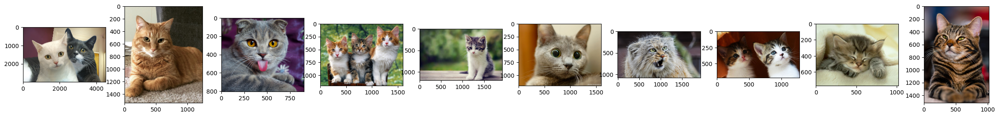

In [ ]:
# Show Cat images

fig, ax = plt.subplots(ncols=len(cat_files), figsize=(30,3))
for i in range(len(cat_files)):
  cat = plt.imread(cat_files[i])
  ax[i].imshow(cat)

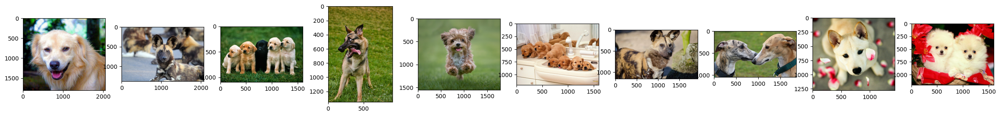

In [ ]:
# Show Dog images

fig, ax = plt.subplots(ncols=len(dog_files), figsize=(30,3))
for i in range(len(dog_files)):
  dog = plt.imread(dog_files[i])
  ax[i].imshow(dog)

## B - Loading Image Data in Tensorflow

### B.1 - First Method : Load images from a directory

The first way to load data with TensorFlow is to use `flow_from_directory`. In this way, TensorFlow will load image data from a folder path.

[*Reference*](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image/ImageDataGenerator#flow_from_directory)

In [ ]:
# Takes the path to a directory & generates batches of augmented data from a directory

IMG_SIZE = 400
path = '/content/images/'

datagen = tf.keras.preprocessing.image.ImageDataGenerator()
data = datagen.flow_from_directory(path, (IMG_SIZE, IMG_SIZE),
                                   batch_size=32,
                                   class_mode='binary', # `class_mode=categorical` for multiclass
                                   shuffle=False)

Found 20 images belonging to 2 classes.


In [ ]:
# Show data type of variable `data`

data

In [ ]:
# Show images in pixel form
print('dimensi  : ', data[0][0].ndim)
print('Images : ', data[0][0])
print('Shape  : ', data[0][0].shape)

dimensi  :  4
Images :  [[[[ 67.  41.  52.]
   [ 64.  38.  51.]
   [ 67.  41.  54.]
   ...
   [125. 101.  75.]
   [118.  94.  68.]
   [114.  94.  70.]]

  [[ 66.  40.  51.]
   [ 67.  41.  54.]
   [ 67.  41.  54.]
   ...
   [123.  99.  73.]
   [120.  96.  70.]
   [126. 106.  82.]]

  [[ 66.  40.  51.]
   [ 66.  40.  51.]
   [ 70.  44.  55.]
   ...
   [126. 104.  80.]
   [121.  99.  75.]
   [117.  95.  74.]]

  ...

  [[230. 238. 240.]
   [234. 239. 242.]
   [235. 240. 243.]
   ...
   [107.  91.  68.]
   [104.  88.  65.]
   [103.  87.  64.]]

  [[229. 237. 239.]
   [233. 238. 241.]
   [235. 240. 243.]
   ...
   [108.  92.  69.]
   [105.  89.  66.]
   [104.  88.  65.]]

  [[226. 238. 238.]
   [226. 238. 238.]
   [229. 241. 241.]
   ...
   [108.  92.  69.]
   [108.  92.  69.]
   [ 99.  83.  60.]]]


 [[[220. 221. 205.]
   [222. 223. 207.]
   [220. 221. 205.]
   ...
   [ 35.  33.  21.]
   [ 42.  40.  28.]
   [ 58.  56.  44.]]

  [[220. 221. 205.]
   [221. 222. 206.]
   [219. 220. 204.]
   .

In [ ]:
# Show classes

print('Class  : ', data[0][1])
print('Shape  : ', data[0][1].shape)

Class  :  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
Shape  :  (20,)


In [ ]:
# Show pixel of first image

print('Pixel : \n', data[0][0][0])
print('Shape : ', data[0][0][0].shape)

Pixel : 
 [[[ 67.  41.  52.]
  [ 64.  38.  51.]
  [ 67.  41.  54.]
  ...
  [125. 101.  75.]
  [118.  94.  68.]
  [114.  94.  70.]]

 [[ 66.  40.  51.]
  [ 67.  41.  54.]
  [ 67.  41.  54.]
  ...
  [123.  99.  73.]
  [120.  96.  70.]
  [126. 106.  82.]]

 [[ 66.  40.  51.]
  [ 66.  40.  51.]
  [ 70.  44.  55.]
  ...
  [126. 104.  80.]
  [121.  99.  75.]
  [117.  95.  74.]]

 ...

 [[230. 238. 240.]
  [234. 239. 242.]
  [235. 240. 243.]
  ...
  [107.  91.  68.]
  [104.  88.  65.]
  [103.  87.  64.]]

 [[229. 237. 239.]
  [233. 238. 241.]
  [235. 240. 243.]
  ...
  [108.  92.  69.]
  [105.  89.  66.]
  [104.  88.  65.]]

 [[226. 238. 238.]
  [226. 238. 238.]
  [229. 241. 241.]
  ...
  [108.  92.  69.]
  [108.  92.  69.]
  [ 99.  83.  60.]]]
Shape :  (400, 400, 3)


In [ ]:
# Index of category

data.class_indices

{'Cats': 0, 'Dogs': 1}

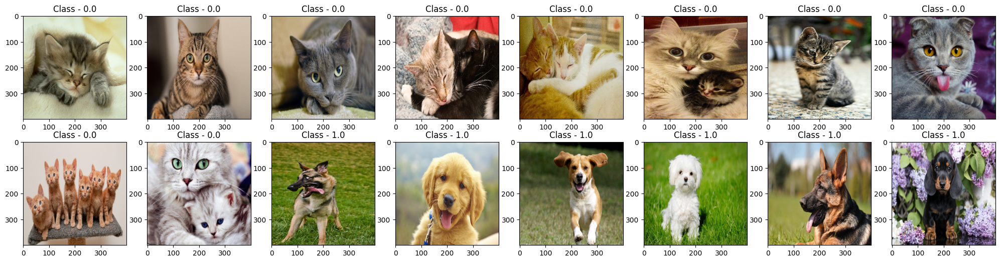

In [ ]:
# Show each of image from both categories

fig, ax = plt.subplots(nrows=2, ncols=8, figsize=(25,6))
n = 0

for i in range(2):
  for j in range(8):
    img = data[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(data[0][1][n]))
    n += 1

In [ ]:
imgen.flow_from_directory?

In [ ]:
# Example of how to split dataset into train-set and validation-set using `flow_from_directory`

imgen = tf.keras.preprocessing.image.ImageDataGenerator(validation_split=0.4)
train = imgen.flow_from_directory(path,
                                  target_size=(400,400),
                                  class_mode='binary',
                                  subset='training',
                                  shuffle=True,
                                  seed=2)
val = imgen.flow_from_directory(path,
                                target_size=(400,400),
                                class_mode='binary',
                                subset='validation',
                                shuffle=True,
                                seed=2)

Found 12 images belonging to 2 classes.
Found 8 images belonging to 2 classes.


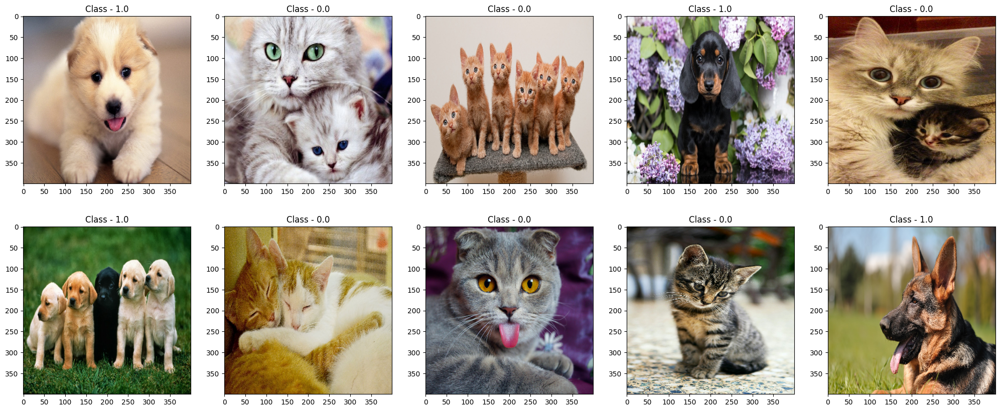

In [ ]:
# Show images of train-set

fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img = train[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train[0][1][n]))
    n += 1

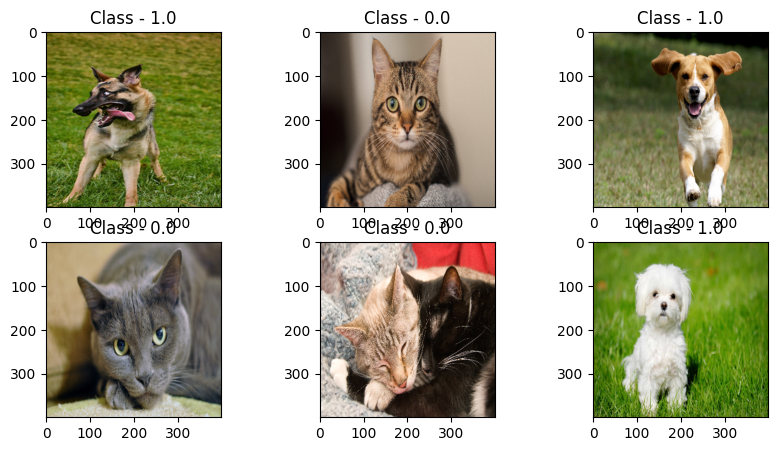

In [ ]:
# Show images of val-set

fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(10,5))
n = 0

for i in range(2):
  for j in range(3):
    img = val[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(val[0][1][n]))
    n += 1

### B.2 - Second Method : Load images from a DataFrame

The second way to load data with TensorFlow is to use `flow_from_dataframe`. In this way, TensorFlow will load image data from a DataFrame that contains image paths.

[*Reference*](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image/ImageDataGenerator#flow_from_dataframe)

In [ ]:
# Show the DataFrame

img_df

,images,label
0,/content/images/Dogs/dog_005.jpg,dogs
1,/content/images/Cats/cat_004.jpg,cats
2,/content/images/Dogs/dog_009.jpg,dogs
3,/content/images/Cats/cat_007.jpg,cats
4,/content/images/Cats/cat_002.jpg,cats
5,/content/images/Dogs/dog_002.jpg,dogs
6,/content/images/Cats/cat_001.jpg,cats
7,/content/images/Cats/cat_009.jpg,cats
8,/content/images/Dogs/dog_008.jpg,dogs
9,/content/images/Dogs/dog_010.jpg,dogs


In [ ]:
# Example of how to split dataset into train-set and validation-set using `flow_from_dataframe`

imgen2 = tf.keras.preprocessing.image.ImageDataGenerator(validation_split=0.4)
train2 = imgen2.flow_from_dataframe(img_df,
                                    x_col='images',
                                    y_col='label',
                                    target_size=(400,400),
                                    class_mode='binary',
                                    subset='training',
                                    shuffle=True,
                                    seed=2)
val2 = imgen2.flow_from_dataframe(img_df,
                                  x_col='images',
                                  y_col='label',
                                  target_size=(400,400),
                                  class_mode='binary',
                                  subset='validation',
                                  shuffle=True,
                                  seed=2)

Found 12 validated image filenames belonging to 2 classes.
Found 8 validated image filenames belonging to 2 classes.


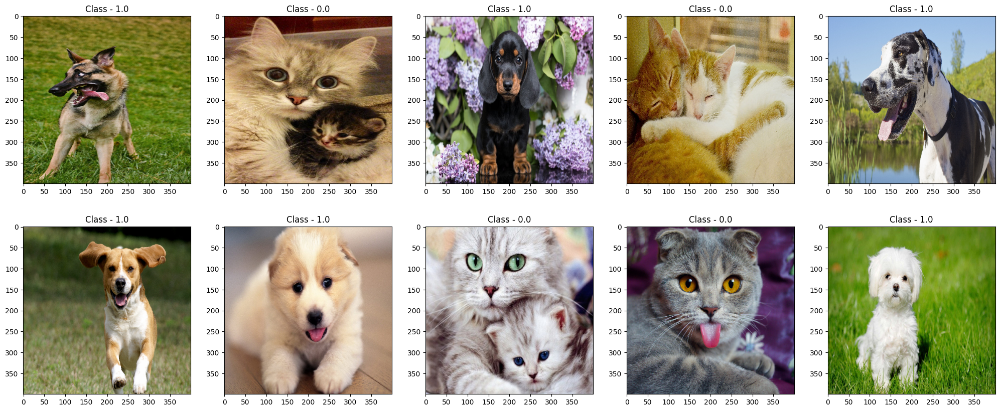

In [ ]:
# Show images of train-set

fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img = train2[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train2[0][1][n]))
    n += 1

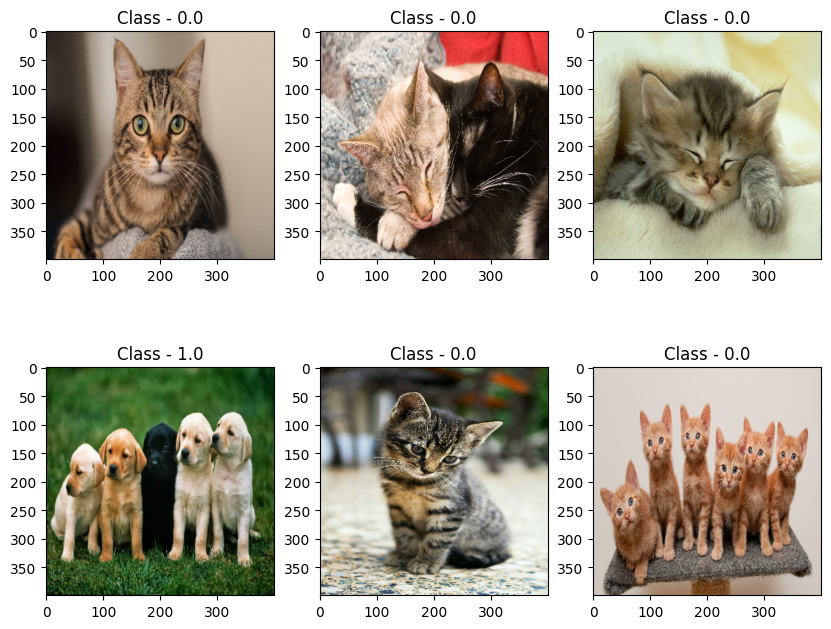

In [ ]:
# Show images of val-set

fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(10,8))
n = 0

for i in range(2):
  for j in range(3):
    img = val2[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(val2[0][1][n]))
    n += 1

## C - Data Augmentation

**Data Augmentation is a technique used to artificially increase the diversity and size of your training dataset.** By applying transformations to your existing data, you can trick your model into thinking it has seen a much larger variety of examples, ultimately leading to better generalization and performance on unseen data.

Some common transformations in an image include Flipping, rotating, cropping, zooming, adjusting brightness and contrast, and adding noise.

Benefits of using Data Augmentation:

* Reduces overfitting
  
  Prevents your model from memorizing specific patterns in your training data, leading to better performance on unseen data.

* Improves generalization
  
  Makes your model more adaptable to real-world scenarios where data might be slightly different from your training set.

* Increases training efficiency
  
  By effectively "multiplying" your dataset, you can train your model with more data without actually needing to collect it, potentially saving time and resources.

Data Augmentation is a powerful tool for improving your model's performance, but **it's important to choose appropriate transformations and use them judiciously to avoid creating unrealistic or nonsensical data.**

### C.1 - Horizontal Flip

Found 12 images belonging to 2 classes.
Found 8 images belonging to 2 classes.


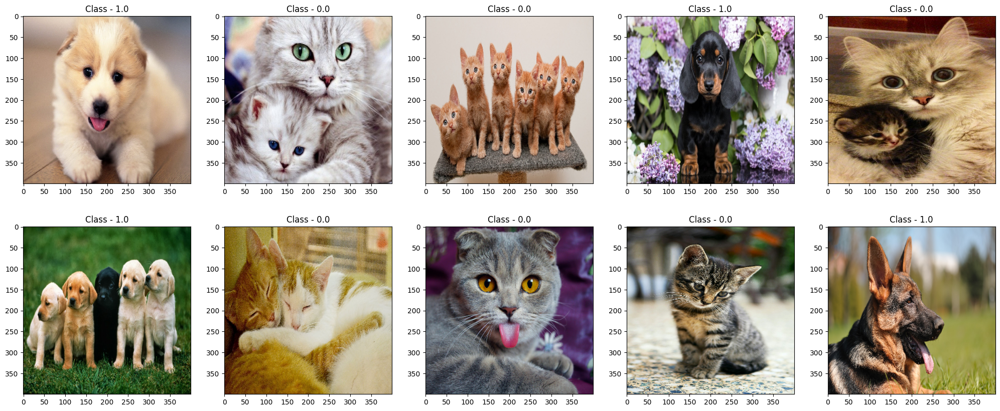

In [ ]:
# Data Augmentation - Horizontal Flip
imgen3 = tf.keras.preprocessing.image.ImageDataGenerator(horizontal_flip=True,
                                                         validation_split=0.4)
train3 = imgen3.flow_from_directory(path,
                                    target_size=(400,400),
                                    class_mode='binary',
                                    subset='training',
                                    shuffle=True,
                                    seed=2)
val3 = imgen3.flow_from_directory(path,
                                  target_size=(400,400),
                                  class_mode='binary',
                                  subset='validation',
                                  shuffle=True,
                                  seed=2)

# Show images of train-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img = train3[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train[0][1][n]))
    n += 1

### C.2 - Vertical Flip

Found 12 images belonging to 2 classes.
Found 8 images belonging to 2 classes.


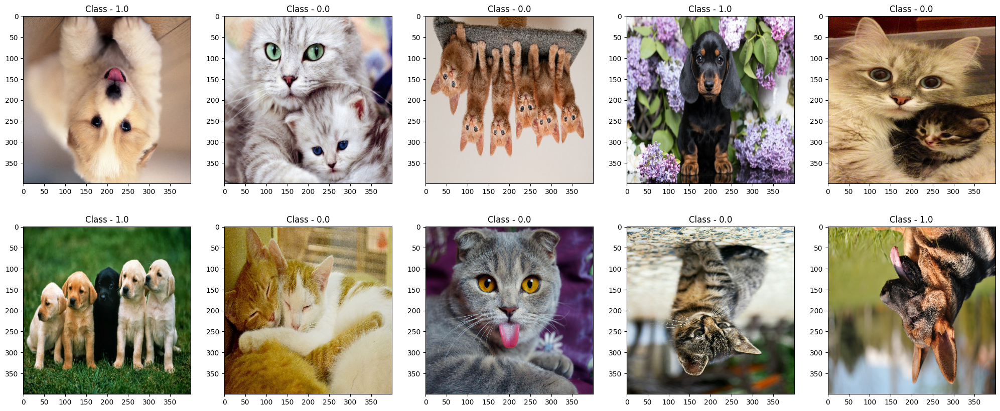

In [ ]:
# Data Augmentation - Vertical Flip
imgen3 = tf.keras.preprocessing.image.ImageDataGenerator(vertical_flip=True,
                                                         validation_split=0.4)
train3 = imgen3.flow_from_directory(path,
                                    target_size=(400,400),
                                    class_mode='binary',
                                    subset='training',
                                    shuffle=True,
                                    seed=2)
val3 = imgen3.flow_from_directory(path,
                                  target_size=(400,400),
                                  class_mode='binary',
                                  subset='validation',
                                  shuffle=True,
                                  seed=2)

# Show images of train-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img = train3[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train[0][1][n]))
    n += 1

### C.3 - Width Shift

Found 12 images belonging to 2 classes.
Found 8 images belonging to 2 classes.


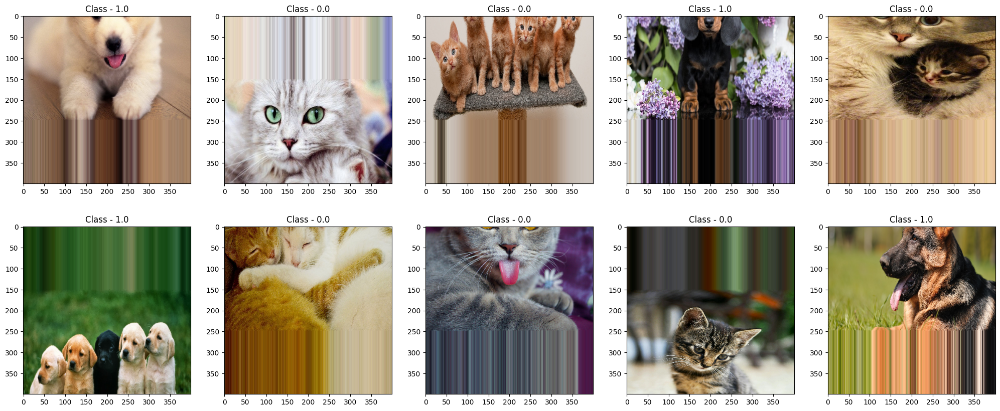

In [ ]:
# Data Augmentation - Width Shift
imgen3 = tf.keras.preprocessing.image.ImageDataGenerator(width_shift_range=[-150, 150],
                                                         validation_split=0.4)
train3 = imgen3.flow_from_directory(path,
                                    target_size=(400,400),
                                    class_mode='binary',
                                    subset='training',
                                    shuffle=True,
                                    seed=2)
val3 = imgen3.flow_from_directory(path,
                                  target_size=(400,400),
                                  class_mode='binary',
                                  subset='validation',
                                  shuffle=True,
                                  seed=2)

# Show images of train-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img = train3[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train[0][1][n]))
    n += 1

### C.4 - Height Shift

Found 12 images belonging to 2 classes.
Found 8 images belonging to 2 classes.


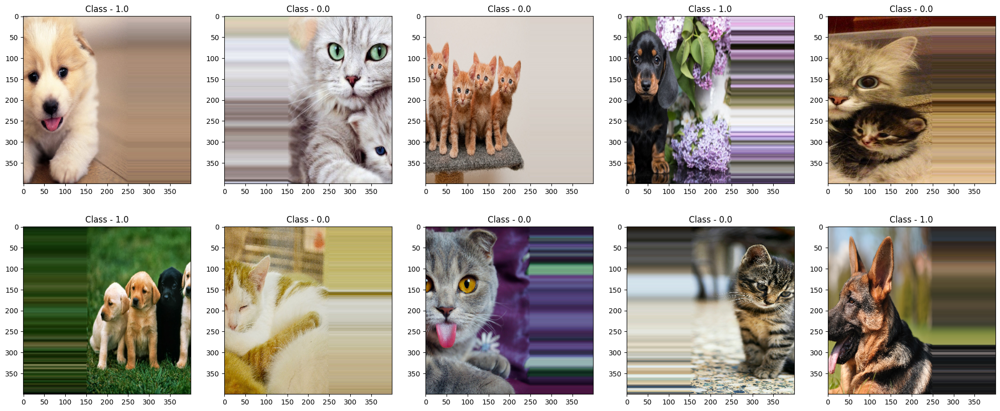

In [ ]:
# Data Augmentation - Height Shift
imgen3 = tf.keras.preprocessing.image.ImageDataGenerator(height_shift_range=[-150, 150],
                                                         validation_split=0.4)
train3 = imgen3.flow_from_directory(path,
                                    target_size=(400,400),
                                    class_mode='binary',
                                    subset='training',
                                    shuffle=True,
                                    seed=2)
val3 = imgen3.flow_from_directory(path,
                                  target_size=(400,400),
                                  class_mode='binary',
                                  subset='validation',
                                  shuffle=True,
                                  seed=2)

# Show images of train-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img = train3[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train[0][1][n]))
    n += 1

### C.5 - Rotation

Found 12 images belonging to 2 classes.
Found 8 images belonging to 2 classes.


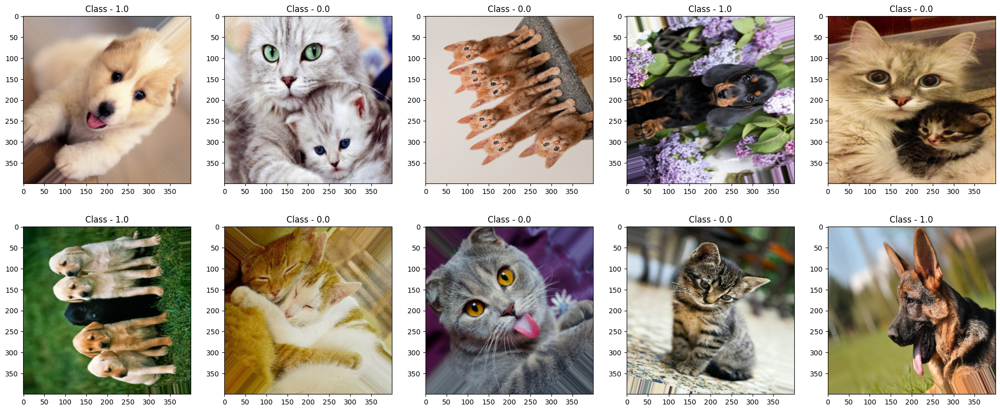

In [ ]:
# Data Augmentation - Rotation
imgen3 = tf.keras.preprocessing.image.ImageDataGenerator(rotation_range=120,
                                                         validation_split=0.4)
train3 = imgen3.flow_from_directory(path,
                                    target_size=(400,400),
                                    class_mode='binary',
                                    subset='training',
                                    shuffle=True,
                                    seed=2)
val3 = imgen3.flow_from_directory(path,
                                  target_size=(400,400),
                                  class_mode='binary',
                                  subset='validation',
                                  shuffle=True,
                                  seed=2)

# Show images of train-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img = train3[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train[0][1][n]))
    n += 1

### C.6 - Zoom

Found 12 images belonging to 2 classes.
Found 8 images belonging to 2 classes.


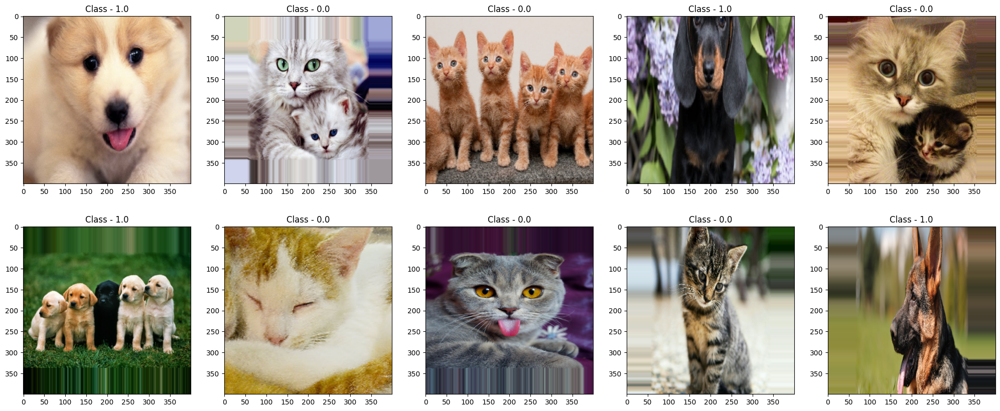

In [ ]:
# Data Augmentation - Zoom
imgen3 = tf.keras.preprocessing.image.ImageDataGenerator(zoom_range=[0.3, 1.5],
                                                         validation_split=0.4)
train3 = imgen3.flow_from_directory(path,
                                    target_size=(400,400),
                                    class_mode='binary',
                                    subset='training',
                                    shuffle=True,
                                    seed=2)
val3 = imgen3.flow_from_directory(path,
                                  target_size=(400,400),
                                  class_mode='binary',
                                  subset='validation',
                                  shuffle=True,
                                  seed=2)

# Show images of train-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img = train3[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train[0][1][n]))
    n += 1

### C.7 - Shear

Found 12 images belonging to 2 classes.
Found 8 images belonging to 2 classes.


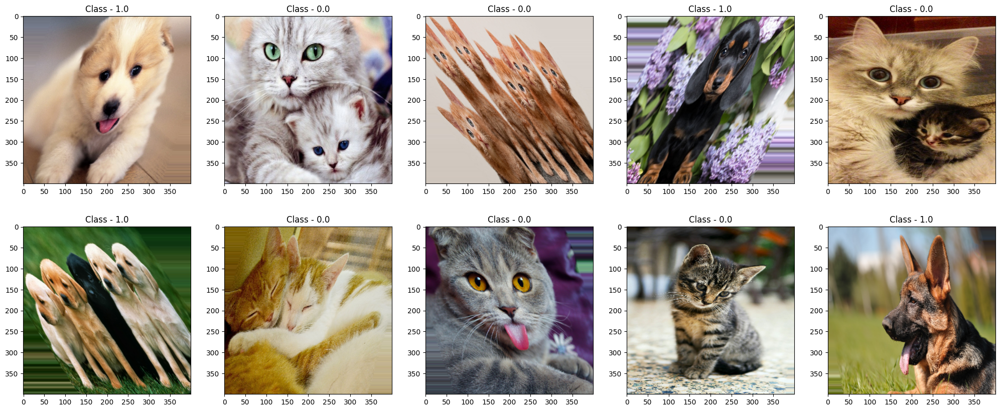

In [ ]:
# Data Augmentation - Shear
imgen3 = tf.keras.preprocessing.image.ImageDataGenerator(shear_range=50,
                                                         validation_split=0.4)
train3 = imgen3.flow_from_directory(path,
                                    target_size=(400,400),
                                    class_mode='binary',
                                    subset='training',
                                    shuffle=True,
                                    seed=2)
val3 = imgen3.flow_from_directory(path,
                                  target_size=(400,400),
                                  class_mode='binary',
                                  subset='validation',
                                  shuffle=True,
                                  seed=2)

# Show images of train-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img = train3[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train[0][1][n]))
    n += 1

### C.8 - Combining All Together

Found 12 images belonging to 2 classes.
Found 8 images belonging to 2 classes.


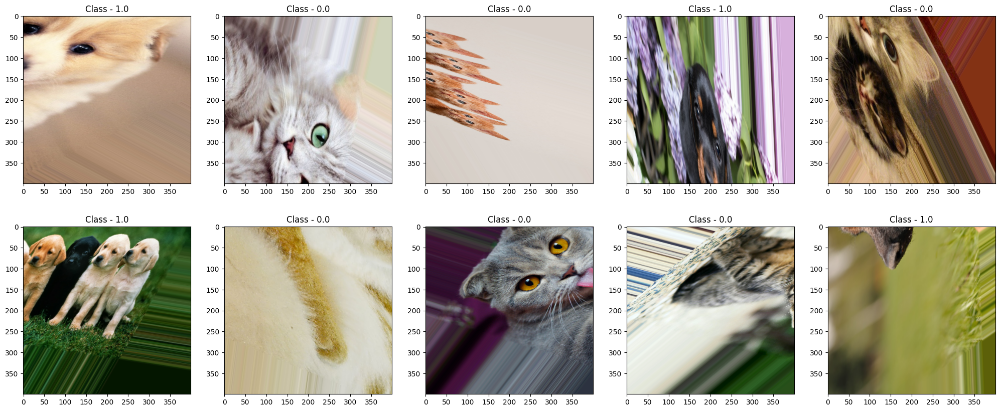

In [ ]:
# Data Augmentation - Combine all previous data augmentations
imgen3 = tf.keras.preprocessing.image.ImageDataGenerator(width_shift_range=[-100, 100],
                                                         height_shift_range=[-100, 100],
                                                         rotation_range=120,
                                                         zoom_range = [0.3, 1.5],
                                                         shear_range=50,
                                                         validation_split=0.4)
train3 = imgen3.flow_from_directory(path,
                                    target_size=(400,400),
                                    class_mode='binary',
                                    subset='training',
                                    shuffle=True,
                                    seed=2)
val3 = imgen3.flow_from_directory(path,
                                  target_size=(400,400),
                                  class_mode='binary',
                                  subset='validation',
                                  shuffle=True,
                                  seed=2)

# Show images of train-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img = train3[0][0][n].astype('uint8')
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train[0][1][n]))
    n += 1